In [1]:
import pandas as pd
import numpy as np
import sklearn as sk
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
data = pd.read_csv("Dataset.csv")
data.head(2)

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,Botswana Pula(P),Yes,No,No,No,3,4.8,Dark Green,Excellent,314
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,Botswana Pula(P),Yes,No,No,No,3,4.5,Dark Green,Excellent,591


## EDA

In [3]:
data.shape                

(9551, 21)

#### The dataset have 9551 rows and 21 columns

In [5]:
data.isna().sum()

Restaurant ID           0
Restaurant Name         0
Country Code            0
City                    0
Address                 0
Locality                0
Locality Verbose        0
Longitude               0
Latitude                0
Cuisines                9
Average Cost for two    0
Currency                0
Has Table booking       0
Has Online delivery     0
Is delivering now       0
Switch to order menu    0
Price range             0
Aggregate rating        0
Rating color            0
Rating text             0
Votes                   0
dtype: int64

#### In given dataset only one column has missing values i.e. "Cuisines"

In [6]:
data["Cuisines"].isna().sum()

9

In [7]:
data["Cuisines"].mode()

0    North Indian
Name: Cuisines, dtype: object

#### here I am filling missing values by most repeaqted value of Cuisines column

In [8]:
data["Cuisines"].fillna(value = "North Indian", inplace = True)

In [9]:
data.columns

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')

#### data type conversion

In [14]:
data.replace({"Yes":1,"No":0}, inplace= True)

In [17]:
data["Currency"].value_counts().to_dict()

{'Indian Rupees(Rs.)': 8652,
 'Dollar($)': 482,
 'Pounds(��)': 80,
 'Brazilian Real(R$)': 60,
 'Emirati Diram(AED)': 60,
 'Rand(R)': 60,
 'NewZealand($)': 40,
 'Turkish Lira(TL)': 34,
 'Botswana Pula(P)': 22,
 'Indonesian Rupiah(IDR)': 21,
 'Qatari Rial(QR)': 20,
 'Sri Lankan Rupee(LKR)': 20}

In [18]:
data.replace({'Indian Rupees(Rs.)':0,'Dollar($)':1,'Pounds(��)':2,'Brazilian Real(R$)':3,'Emirati Diram(AED)':4,'Rand(R)':5,
           'NewZealand($)':6,'Turkish Lira(TL)':7,'Botswana Pula(P)':8,'Indonesian Rupiah(IDR)':9,'Qatari Rial(QR)':10,
           'Sri Lankan Rupee(LKR)':11},inplace= True)

In [19]:
data["Rating color"].value_counts().to_dict()

{'Orange': 3737,
 'White': 2148,
 'Yellow': 2100,
 'Green': 1079,
 'Dark Green': 301,
 'Red': 186}

In [20]:
data.replace({'Orange':0,'White':1,'Yellow':2,'Green':3,'Dark Green':4,'Red':5},inplace = True)

In [21]:
data["Rating text"].value_counts().to_dict()

{'Average': 3737,
 'Not rated': 2148,
 'Good': 2100,
 'Very Good': 1079,
 'Excellent': 301,
 'Poor': 186}

In [22]:
data.replace({'Average':2,
 'Not rated':0,
 'Good':3,
 'Very Good':4,
 'Excellent':5,
 'Poor':1}, inplace = True )

In [28]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9551 entries, 0 to 9550
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Restaurant ID         9551 non-null   int64  
 1   Restaurant Name       9551 non-null   object 
 2   Country Code          9551 non-null   int64  
 3   City                  9551 non-null   object 
 4   Address               9551 non-null   object 
 5   Locality              9551 non-null   object 
 6   Locality Verbose      9551 non-null   object 
 7   Longitude             9551 non-null   float64
 8   Latitude              9551 non-null   float64
 9   Cuisines              9551 non-null   object 
 10  Average Cost for two  9551 non-null   int64  
 11  Currency              9551 non-null   int64  
 12  Has Table booking     9551 non-null   int64  
 13  Has Online delivery   9551 non-null   int64  
 14  Is delivering now     9551 non-null   int64  
 15  Switch to order menu 

#### distribution of the target variable ("Aggregate rating")

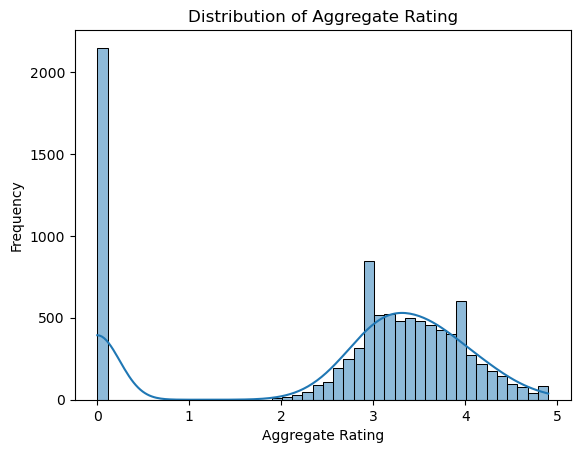

In [26]:
# Plot the distribution of 'Aggregate rating'
sns.histplot(data['Aggregate rating'], kde=True)
plt.title('Distribution of Aggregate Rating')
plt.xlabel('Aggregate Rating')
plt.ylabel('Frequency')
plt.show()

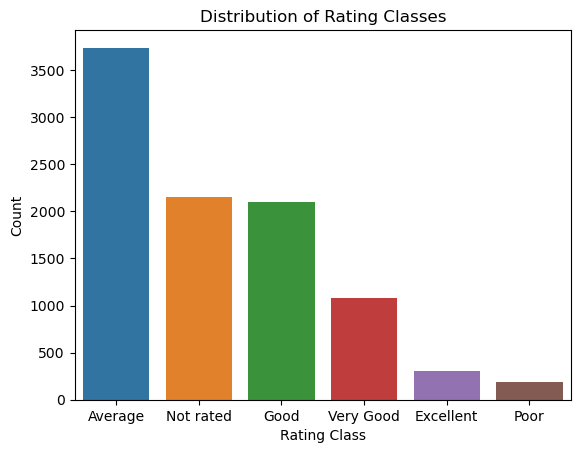

In [33]:
# Count the occurrences of each rating class
rating_counts = data['Rating text'].value_counts()

# Plot the counts
sns.barplot(x=['Average','Not rated','Good','Very Good','Excellent','Poor'], y=rating_counts.values)
plt.title('Distribution of Rating Classes')
plt.xlabel('Rating Class')
plt.ylabel('Count')
plt.show()


## Task: Descriptive Analysis

In [4]:
from summarytools import dfSummary
dfSummary(data)

No,Variable,Stats / Values,Freqs / (% of Valid),Graph,Missing
1,Restaurant ID[int64],Mean (sd) : 9051128.3 (8791521.3)min < med < max:53.0 < 6004089.0 < 18500652.0IQR (CV) : 18050329.0 (1.0),"9,551 distinct values","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjUuMiwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8qNh9FAAAACXBIWXMAAA9hAAAPYQGoP6dpAAACPklEQVR4nO3YQYriQBiG4b9GDUnLVAgB3XmBhlm4zCH6sH2ILOYkIi2SoK0oMbOYdU8npUE/53228leV8JYUurZtDXh0P+59AKCL8b0PgOfhnEvMLAocP7Vte/jqQ0LFTTjnkjzP37z3Wch8Xddb59z7V7F+G+qQtwRPJfLeZ0VRHNI0PfYZrKoqLssy22w2kZn1D3XoW4Lnk6bpcTabfQaMJv/68Ltf1EFvCdBVpzfqULcE6Iq/pyCBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCGBUCFhfO8DDMU5l5hZdMUSp7ZtD7c6D64zaKhN00zMzDvnQpcIisU5l+R5/ua9z0I3rut665x7J9bHMFio+/1+cj6ffy0Wi9FoNDqGrHFFLJH3PiuK4pCmae+9q6qKy7LMNptNZGaE+gAGC/V0Oo3jOH5ZLpfH+Xy+7Tt/i1jSND3OZrPPkFkzSwLnMIDB36jT6TQ4lqZpvIU9HfzlcpmE7InH1CnUqqrivgvvdrvYzGy/38fr9fql7/xqtfoZ+nQ4n89x0zSvHx8fv/vua/b3+zZNM7br3tf/G3+5XMYhrXSZ+QN9oLPGZALIEwAAAABJRU5ErkJggg=="">",0(0.0%)
2,Restaurant Name[object],1. Cafe Coffee Day2. Domino's Pizza3. Subway4. Green Chick Chop5. McDonald's6. Keventers7. Pizza Hut8. Giani9. Baskin Robbins10. Barbeque Nation11. other,"83 (0.9%)79 (0.8%)63 (0.7%)51 (0.5%)48 (0.5%)34 (0.4%)30 (0.3%)29 (0.3%)28 (0.3%)26 (0.3%)9,080 (95.1%)","<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAJsAAAD+CAYAAAAtWHdlAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjUuMiwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8qNh9FAAAACXBIWXMAAA9hAAAPYQGoP6dpAAADpElEQVR4nO3csW0jVxhG0X8EQl4lQxAEVILdg4rYYrcIFuEeBEETWGsldLAOrV0H9iU8PicSwOQFF3wkMZ+W6/U6ULi79QH4/xAbGbGRERsZsZERGxmxkREbGbGRWWbmYWbmer2+3fgs7NzhfD5/nplZluWL4Pg33a3relrX9TQz97c+DPvmMxsZsZERGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERGxmxkTls2/by59/vNz0Ju2eDQGbxL7OoeGcjY11FxrqKjJ8+yIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIGLyQ8Vg4GYMXMt7ZyBi8kDF4IeOnDzJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MgYvZDwWTsbghYzPbGRco2Ssq8hYV5HxmY2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYx1FRmPhZOxriLjnY2MwQsZgxcyfvogIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MmIjIzYyYiNj8ELGY+FkDF7IeGcjY/BCxuCFjJ8+yIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2MdRUZGwQy1lVkfGYjc7csyy/Lsny69UHYv7uZ+Xlmfrr1Qdg/1ygZsZERGxmxkREbGbGRERsZsZERGxmxkREbGbGRERsZsZERG5m7mfl1Zn6/9UHYPxsEMq5RMmIjY/BCxuCFjGuUjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2MwQsZgxcyrlEyYiMjNjLWVWSsq8i4RsmIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyFhXkbGuIuMaJSM2MgYvZAxeyLhGyYiNjNjIiI2M2MiIjYzYyIiNjNjIiI2M2MiIjYzYyIiNjNjIGLyQMXgh4xols8zMw8zc3/og7ML79Xp9++jFw/l8/ryu66k8Efu0bdvLsixfPgrusK7r6enp6e14PH6tD8d+vL6+frpcLqfn5+f7mfnr2GZmjsfj18fHx9/S07FHD9970RcEMmIjIzYyYiMjNjJiIyM2MmIjIzYyYiMjNjJiIyM2MoeZb4+H3Pog/Lf9nYYO27a9XC6X0/zg8RD4kW3bXmbm/aPXPRbOP+m7j4VbV5HxBYGM2MiIjYzYyIiNjNjIiI2M2MiIjcwfgn7PUCz4/coAAAAASUVORK5CYII="">",0(0.0%)
3,Country Code[int64],Mean (sd) : 18.4 (56.8)min < med < max:1.0 < 1.0 < 216.0IQR (CV) : 0.0 (0.3),15 distinct values,"<img src = ""data:image/png;base64, iVBORw0KGgoAAAANSUhEUgAAAKoAAABGCAYAAABc8A97AAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjUuMiwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8qNh9FAAAACXBIWXMAAA9hAAAPYQGoP6dpAAAB2klEQVR4nO3XTWrjQBCG4arBERIM3cgCXSI30D7bHDaH0GLOYhFai9jEyJ1dGBgSW21nMt/wPlupil686Mdzzgb863589wGAS2zO3eDujZlVhftfc877wlng3aehunvTdd1jCKEtWT7P87O7PxErrnXuiVqFENphGPYxxsOaxSmlehzHdpqmyswIFVc5++o3M4sxHvq+fynY3xTMAH/gZwoSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSCBUSNt99APw/3L0xs6pw/DXnvP/oIqHiJty96bruMYTQlszP8/zs7k8fxUqouJUqhNAOw7CPMR7WDKaU6nEc22maKjMjVHy9GOOh7/uXgtHms4uEindXfmOG0+l0d8vz/O6iUFNK9drFKaV6WZaNmQV3X30w/HX1drt9iDH+LBk+Ho/1siz3u93u19rZS/p6A1ZxVhz1AuO4AAAAAElFTkSuQmCC"">",0(0.0%)

In [37]:
data.describe(exclude=['O'])

,Restaurant ID,Country Code,Longitude,Latitude,Average Cost for two,Currency,Has Table booking,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes
count,9.551000e+03,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000,9551.0,9551.000000,9551.000000,9551.000000,9551.000000,9551.000000
mean,9.051128e+06,18.365616,64.126574,25.854381,1199.210763,0.274840,0.121244,0.256622,0.003560,0.0,1.804837,2.666370,1.226992,2.071092,156.909748
std,8.791521e+06,56.750546,41.467058,11.007935,16121.183073,1.198408,0.326428,0.436792,0.059561,0.0,0.905609,1.516378,1.267635,1.367335,430.169145
min,5.300000e+01,1.000000,-157.948486,-41.330428,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,0.000000,0.000000,0.000000,0.000000
25%,3.019625e+05,1.000000,77.081343,28.478713,250.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000,2.500000,0.000000,2.000000,5.000000
50%,6.004089e+06,1.000000,77.191964,28.570469,400.000000,0.000000,0.000000,0.000000,0.000000,0.0,2.000000,3.200000,1.000000,2.000000,31.000000
75%,1.835229e+07,1.000000,77.282006,28.642758,700.000000,0.000000,0.000000,1.000000,0.000000,0.0,2.000000,3.700000,2.000000,3.000000,131.000000
max,1.850065e+07,216.000000,174.832089,55.976980,800000.000000,11.000000,1.000000,1.000000,1.000000,0.0,4.000000,4.900000,5.000000,5.000000,10934.000000


#### destribution of catagorical columns

In [44]:
# Plot the distribution of 'City'
plt.figure(figsize=(250,50))
sns.histplot(data['City'], kde=True)
plt.title('Distribution of City')
plt.xlabel('City')
plt.ylabel('Frequency')
plt.show()

In [45]:
# Plot the distribution of 'Cuisines'
plt.figure(figsize=(250,50))
sns.histplot(data['Cuisines'], kde=True)
plt.title('Distribution of Cuisines')
plt.xlabel('Cuisines')
plt.ylabel('Frequency')
plt.show()

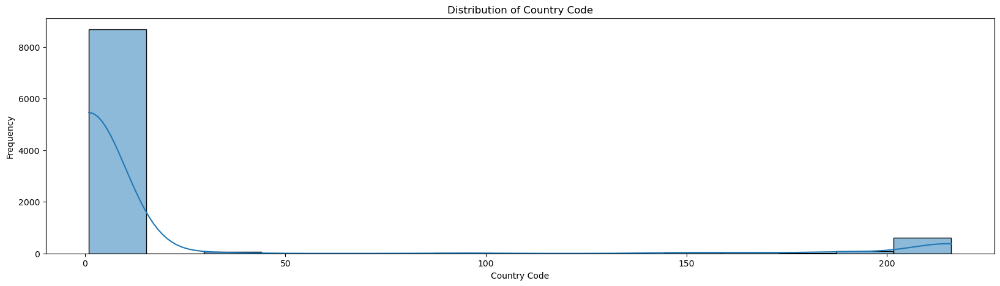

In [48]:
# Plot the distribution of 'Country Code'
plt.figure(figsize=(20,5))
sns.histplot(data['Country Code'], kde=True)
plt.title('Distribution of Country Code')
plt.xlabel('Country Code')
plt.ylabel('Frequency')
plt.show()

#### To 30 Cuisines who has highest number of restaurants

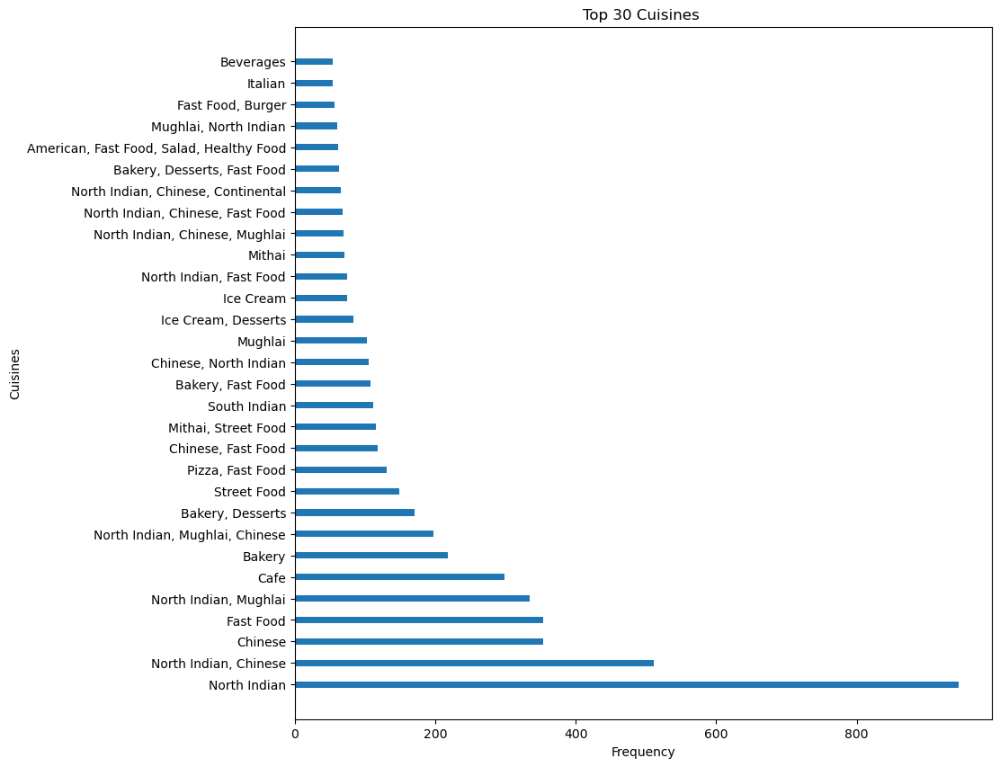

In [61]:
plt.figure(figsize=(10,10))
category_counts = data['Cuisines'].value_counts().head(30)
plt.barh(category_counts.index, category_counts.values, 0.3)
plt.xlabel('Frequency')
plt.ylabel('Cuisines')
plt.title('Top 30 Cuisines ')
plt.show()

#### To 10 Citys who has highest number of restaurants

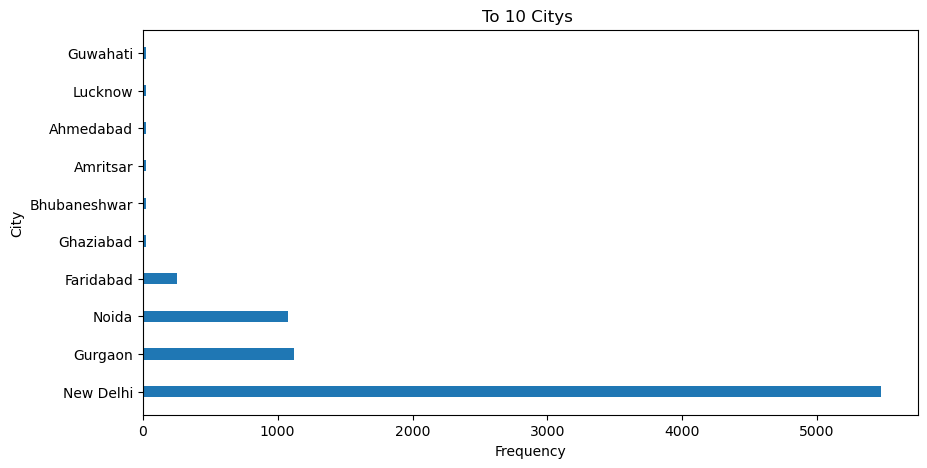

In [60]:
plt.figure(figsize=(10,5))
category_counts = data['City'].value_counts().head(10)
plt.barh(category_counts.index, category_counts.values, 0.3)
plt.xlabel('Frequency')
plt.ylabel('City')
plt.title('To 10 Citys ')
plt.show()

## Task: Geospatial Analysis

In [63]:
#pip install folium

In [65]:
import folium
from folium.plugins import MarkerCluster

# I Create a map centered at the mean latitude and longitude
map_restaurants = folium.Map(location=[data['Latitude'].mean(), data['Longitude'].mean()], zoom_start=10)

# I Create a MarkerCluster layer for better visualization of multiple markers
marker_cluster = MarkerCluster().add_to(map_restaurants)

# Added a markers for each restaurant
for idx, row in data.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']], popup=row['Restaurant Name']).add_to(marker_cluster)

# Display the map
map_restaurants

####   The distribution of restaurants across cities

In [68]:
city_counts = data['City'].value_counts()

plt.figure(figsize=(250, 50))
city_counts.plot(kind='bar')
plt.title('Distribution of Restaurants Across Cities')
plt.xlabel('City')
plt.ylabel('Number of Restaurants')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.show()

#### The distribution of restaurants across countries

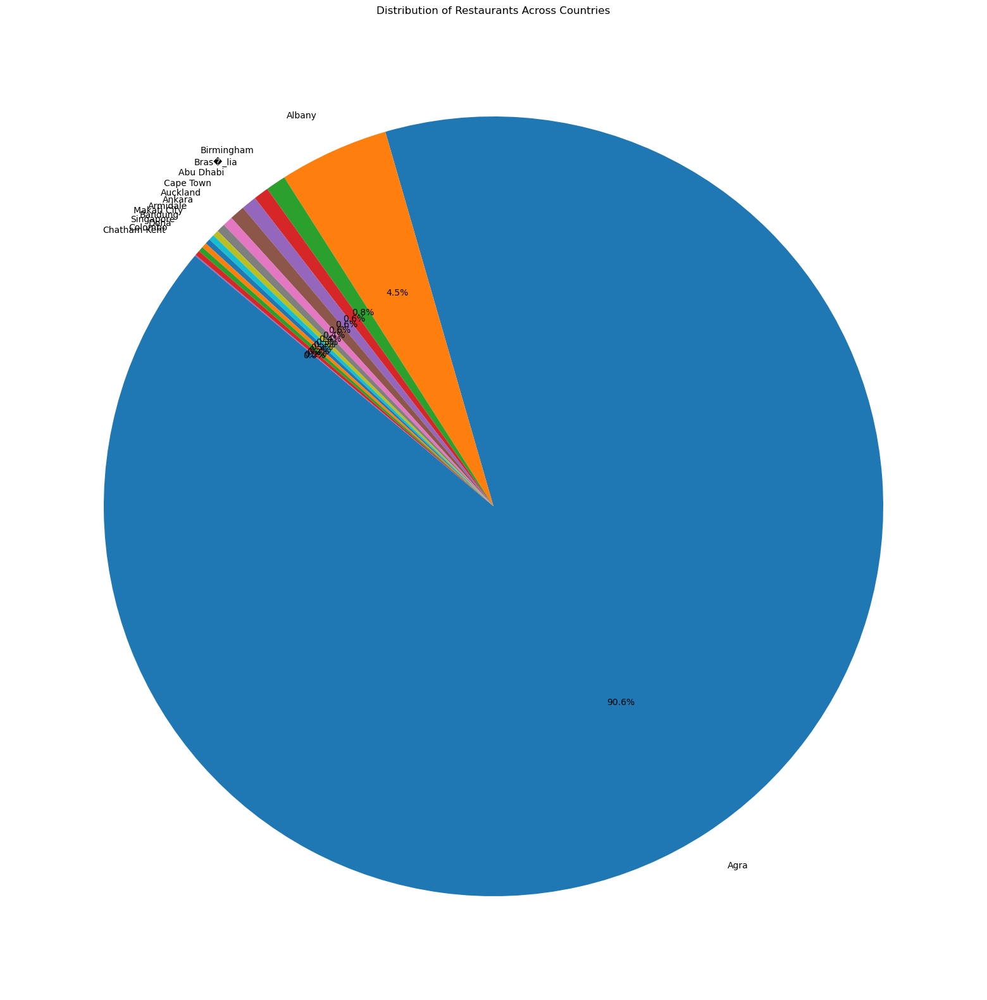

In [72]:
# Count the number of restaurants in each country
country_counts = data['Country Code'].value_counts()

# Get the country names from country codes
country_names = [data[data['Country Code'] == code]['City'].iloc[0] for code in country_counts.index]

# Plot the distribution of restaurants across countries
plt.figure(figsize=(50,20))
plt.pie(country_counts, labels=country_names, autopct='%1.1f%%', startangle=140)
plt.title('Distribution of Restaurants Across Countries')
plt.show()


In [73]:
correlation_lat_rating = data['Latitude'].corr(data['Aggregate rating'])
correlation_lon_rating = data['Longitude'].corr(data['Aggregate rating'])

print("Correlation coefficient between Latitude and Rating:", correlation_lat_rating)
print("Correlation coefficient between Longitude and Rating:", correlation_lon_rating)


Correlation coefficient between Latitude and Rating: 0.0005155806902359819
Correlation coefficient between Longitude and Rating: -0.11681757734540407


### from above calculations we can conclude that thier is no corellation between Latitude, Longitude and Rating

## Task: Table Booking and Online Delivery

In [74]:
# Count the occurrences of 'Yes' in 'Has Table booking' column
table_booking_count = data['Has Table booking'].value_counts().get(1, 0)

# Count the occurrences of 'Yes' in 'Has Online delivery' column
online_delivery_count = data['Has Online delivery'].value_counts().get(1, 0)

# The percentage of restaurants offering table booking and online delivery
total_restaurants = len(data)
percentage_table_booking = (table_booking_count / total_restaurants) * 100
percentage_online_delivery = (online_delivery_count / total_restaurants) * 100

print("Percentage of restaurants that offer table booking: {:.2f}%".format(percentage_table_booking))
print("Percentage of restaurants that offer online delivery: {:.2f}%".format(percentage_online_delivery))


Percentage of restaurants that offer table booking: 12.12%
Percentage of restaurants that offer online delivery: 25.66%


In [77]:
# The mean aggregate rating for restaurants with table booking
mean_rating_with_booking = data[data['Has Table booking'] == 1]['Aggregate rating'].mean()

# The mean aggregate rating for restaurants without table booking
mean_rating_without_booking = data[data['Has Table booking'] == 0]['Aggregate rating'].mean()

print("Average rating for restaurants with table booking:", mean_rating_with_booking)
print("Average rating for restaurants without table booking:", mean_rating_without_booking)


Average rating for restaurants with table booking: 3.4419689119170966
Average rating for restaurants without table booking: 2.55935898963422


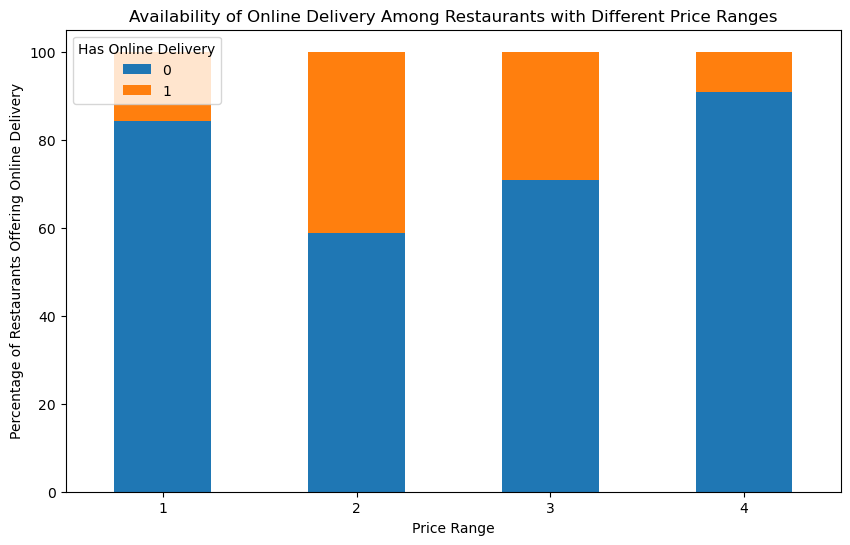

In [78]:
# Group the data by price range and to the percentage of restaurants offering online delivery in each group
online_delivery_percentages = data.groupby('Price range')['Has Online delivery'].value_counts(normalize=True).unstack().fillna(0) * 100

# Plot the results
online_delivery_percentages.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Availability of Online Delivery Among Restaurants with Different Price Ranges')
plt.xlabel('Price Range')
plt.ylabel('Percentage of Restaurants Offering Online Delivery')
plt.xticks(rotation=0)
plt.legend(title='Has Online Delivery', loc='upper left')
plt.show()


## Task: Price Range Analysis

In [81]:
price_range_counts = data['Price range'].value_counts()
price_range_counts

1    4444
2    3113
3    1408
4     586
Name: Price range, dtype: int64

### form above result we can comclude that The most common price range among all the restaurants is: 1

### average rating for each price range

In [85]:
# Group the data by price range and to the mean aggregate rating for each group
average_rating_by_price_range = data.groupby('Price range')['Aggregate rating'].mean()

# Print the results
print("Average rating for each price range:")
print(average_rating_by_price_range)


Average rating for each price range:
Price range
1    1.999887
2    2.941054
3    3.683381
4    3.817918
Name: Aggregate rating, dtype: float64


In [88]:
# Group the data by both price range and rating color, and to the mean aggregate rating for each group
average_rating_by_price_and_color = data.groupby(['Price range', 'Rating color'])['Aggregate rating'].mean()

# Find the color with the highest average rating across all price ranges
highest_rating_color = average_rating_by_price_and_color.unstack().idxmax().max()
# {'Orange':0,'White':1,'Yellow':2,'Green':3,'Dark Green':4,'Red':5}
print("The color that represents the highest average rating among different price ranges is:", highest_rating_color,"(Dark Green)")


The color that represents the highest average rating among different price ranges is: 4 (Dark Green)


## Task: Feature Engineering

In [110]:
# Convert the 'Restaurant Name' and 'Address' columns to strings
data['Restaurant Name'] = data['Restaurant Name'].astype(str)
data['Address'] = data['Address'].astype(str)

# Extract the length of the restaurant name and address and create new columns
data['Restaurant Name Length'] = data['Restaurant Name'].apply(len)
data['Address Length'] = data['Address'].apply(len)

# Display the updated DataFrame with the new columns
data.head()

,Restaurant ID,Restaurant Name,Country Code,City,Address,Locality,Locality Verbose,Longitude,Latitude,Cuisines,...,Has Online delivery,Is delivering now,Switch to order menu,Price range,Aggregate rating,Rating color,Rating text,Votes,Restaurant Name Length,Address Length
0,6317637,Le Petit Souffle,162,Makati City,"Third Floor, Century City Mall, Kalayaan Avenu...","Century City Mall, Poblacion, Makati City","Century City Mall, Poblacion, Makati City, Mak...",121.027535,14.565443,"French, Japanese, Desserts",...,0,0,0,3,4.8,4,5,314,16,71
1,6304287,Izakaya Kikufuji,162,Makati City,"Little Tokyo, 2277 Chino Roces Avenue, Legaspi...","Little Tokyo, Legaspi Village, Makati City","Little Tokyo, Legaspi Village, Makati City, Ma...",121.014101,14.553708,Japanese,...,0,0,0,3,4.5,4,5,591,16,67
2,6300002,Heat - Edsa Shangri-La,162,Mandaluyong City,"Edsa Shangri-La, 1 Garden Way, Ortigas, Mandal...","Edsa Shangri-La, Ortigas, Mandaluyong City","Edsa Shangri-La, Ortigas, Mandaluyong City, Ma...",121.056831,14.581404,"Seafood, Asian, Filipino, Indian",...,0,0,0,4,4.4,3,4,270,22,56
3,6318506,Ooma,162,Mandaluyong City,"Third Floor, Mega Fashion Hall, SM Megamall, O...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.056475,14.585318,"Japanese, Sushi",...,0,0,0,4,4.9,4,5,365,4,70
4,6314302,Sambo Kojin,162,Mandaluyong City,"Third Floor, Mega Atrium, SM Megamall, Ortigas...","SM Megamall, Ortigas, Mandaluyong City","SM Megamall, Ortigas, Mandaluyong City, Mandal...",121.057508,14.584450,"Japanese, Korean",...,0,0,0,4,4.8,4,5,229,11,64


## Task: Predictive Modeling


In [157]:
selected_features = [ 'Price range', 'Has Table booking','Has Online delivery', 'Is delivering now',"Average Cost for two", 
                     'Latitude', 'Longitude',  'Country Code','Votes','Restaurant Name Length', 'Address Length',
                     ]
X = data[selected_features] 
y = data["Aggregate rating"]

In [131]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor

In [158]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size= 0.2, random_state=0)

In [159]:
def evaluate_model(model, X_train, X_test, y_train, y_test):
    # Train the model on the training set
    model.fit(X_train, y_train)
    
    # Make predictions on the training set
    y_train_pred = model.predict(X_train)
    
    # Make predictions on the testing set
    y_test_pred = model.predict(X_test)
    
    # Calculate evaluation metrics for training set
    mse_train = mean_squared_error(y_train, y_train_pred)
    mae_train = mean_absolute_error(y_train, y_train_pred)
    r2_train = r2_score(y_train, y_train_pred)
    
    # Calculate evaluation metrics for testing set
    mse_test = mean_squared_error(y_test, y_test_pred)
    mae_test = mean_absolute_error(y_test, y_test_pred)
    r2_test = r2_score(y_test, y_test_pred)
    
    # Model score
    model_score = model.score(X, y)
    
    
    return {
        'mse_train': mse_train,
        'mae_train': mae_train,
        'r2_train': r2_train,
        'mse_test': mse_test,
        'mae_test': mae_test,
        'r2_test': r2_test,
        'model_score': model_score
    }

# Initialize different algorithms
linear_reg = LinearRegression()
decision_tree = DecisionTreeRegressor(random_state=42)
random_forest = RandomForestRegressor(random_state=42)

# Evaluate each model
results_lr = evaluate_model(linear_reg, X_train, X_test, y_train, y_test)
results_dt = evaluate_model(decision_tree, X_train, X_test, y_train, y_test)
results_rf = evaluate_model(random_forest, X_train, X_test, y_train, y_test)

# Print evaluation results
print("Linear Regression:")
print("  Training MSE:", results_lr['mse_train'])
print("  Training MAE:", results_lr['mae_train'])
print("  Training R-squared:", results_lr['r2_train'])
print()
print("  Testing MSE:", results_lr['mse_test'])
print("  Testing MAE:", results_lr['mae_test'])
print("  Testing R-squared:", results_lr['r2_test'])
print()
print("  Model Score :", results_lr['model_score'])
print()
print("*"*100)
print("Decision Tree:")
print("  Training MSE:", results_dt['mse_train'])
print("  Training MAE:", results_dt['mae_train'])
print("  Training R-squared:", results_dt['r2_train'])
print()
print("  Testing MSE:", results_dt['mse_test'])
print("  Testing MAE:", results_dt['mae_test'])
print("  Testing R-squared:", results_dt['r2_test'])
print()
print("  Model Score :", results_dt['model_score'])
print()
print("*"*100)
print("Random Forest:")
print("  Training MSE:", results_rf['mse_train'])
print("  Training MAE:", results_rf['mae_train'])
print("  Training R-squared:", results_rf['r2_train'])
print()
print("  Testing MSE:", results_rf['mse_test'])
print("  Testing MAE:", results_rf['mae_test'])
print("  Testing R-squared:", results_rf['r2_test'])
print()
print("  Model Score:", results_rf['model_score'])
print("*"*100)

Linear Regression:
  Training MSE: 1.5973782602740676
  Training MAE: 1.0518169220432625
  Training R-squared: 0.2993442987137954

  Testing MSE: 1.6004283567439963
  Testing MAE: 1.0505632926514998
  Testing R-squared: 0.3263725346595837

  Model Score : 0.30496856660716887

****************************************************************************************************
Decision Tree:
  Training MSE: 5.31758332707881e-33
  Training MAE: 1.1276610826035621e-17
  Training R-squared: 1.0

  Testing MSE: 0.19886970172684457
  Testing MAE: 0.2837257980115123
  Testing R-squared: 0.9162948515984788

  Model Score : 0.9826934201041196

****************************************************************************************************
Random Forest:
  Training MSE: 0.013523820680628278
  Training MAE: 0.07487591623036652
  Training R-squared: 0.9940680662190627

  Testing MSE: 0.10109410832025116
  Testing MAE: 0.2088670852956567
  Testing R-squared: 0.9574490369021164

  Model Score: 0.

## Task: Customer Preference Analysis

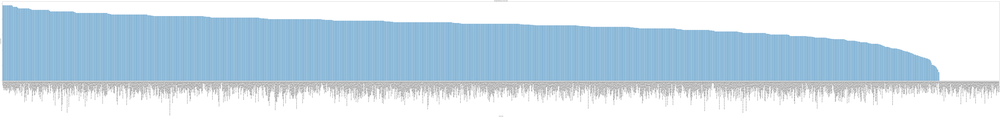

In [141]:
# Group the data by cuisine type and calculate the average rating for each cuisine
average_rating_by_cuisine = data.groupby('Cuisines')['Aggregate rating'].mean().sort_values(ascending=False)

# Plot the average rating for each cuisine
average_rating_by_cuisine.plot(kind='bar', figsize=(250, 20))
plt.title('Average Rating by Cuisine Type')
plt.xlabel('Cuisine Type')
plt.ylabel('Average Rating')
plt.xticks(rotation=90)
plt.show()


In [143]:
# Group the data by cuisine type and calculate the total number of votes for each cuisine
total_votes_by_cuisine = data.groupby('Cuisines')['Votes'].sum().sort_values(ascending=False)

# Plot the total number of votes for each cuisine
total_votes_by_cuisine.plot(kind='bar', figsize=(250, 25))
plt.title('Total Number of Votes by Cuisine Type')
plt.xlabel('Cuisine Type')
plt.ylabel('Total Votes')
plt.xticks(rotation=90)
plt.show()


### Cuisines with higher average ratings are likely to receive more positive reviews from customers.

## Task: Data Visualization

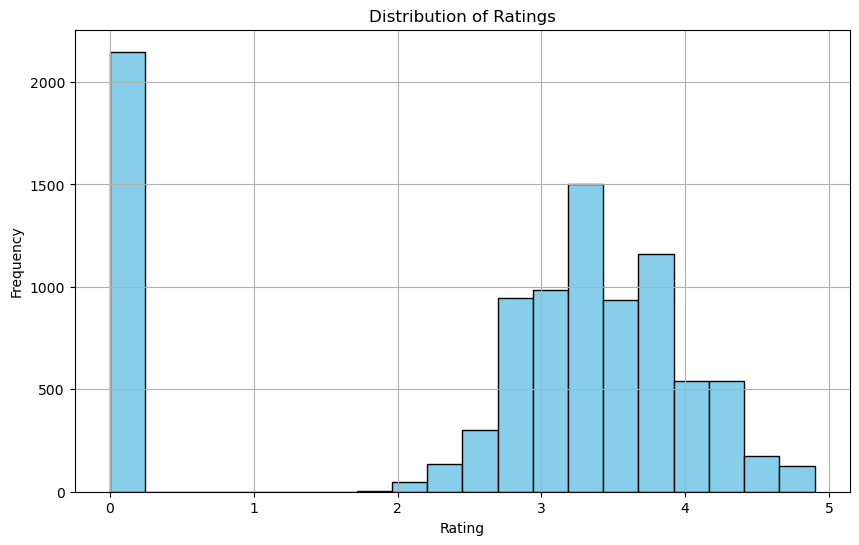

In [144]:
# Plot a histogram of the ratings distribution
plt.figure(figsize=(10, 6))
plt.hist(data['Aggregate rating'], bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Ratings')
plt.xlabel('Rating')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


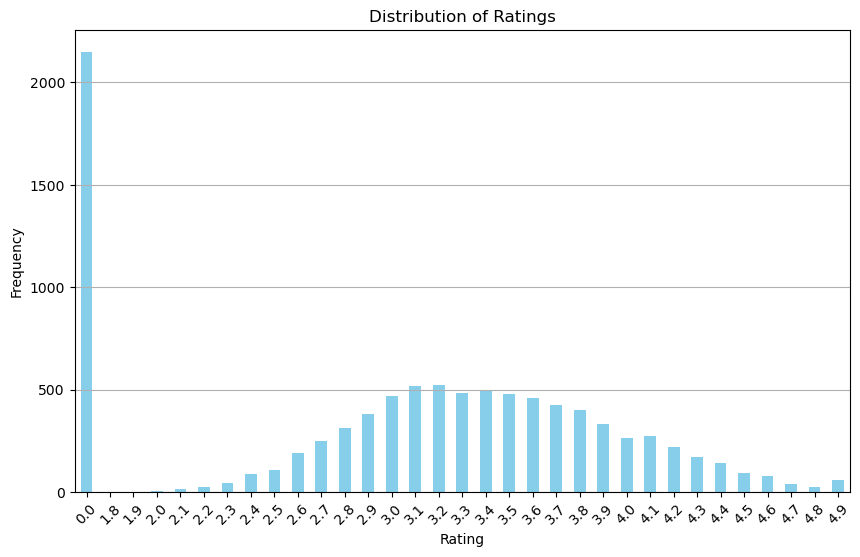

In [145]:
# Group the data by rating and count the number of occurrences
rating_counts = data['Aggregate rating'].value_counts().sort_index()

# Plot a bar plot of the ratings distribution
plt.figure(figsize=(10, 6))
rating_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Ratings')
plt.xlabel('Rating')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()


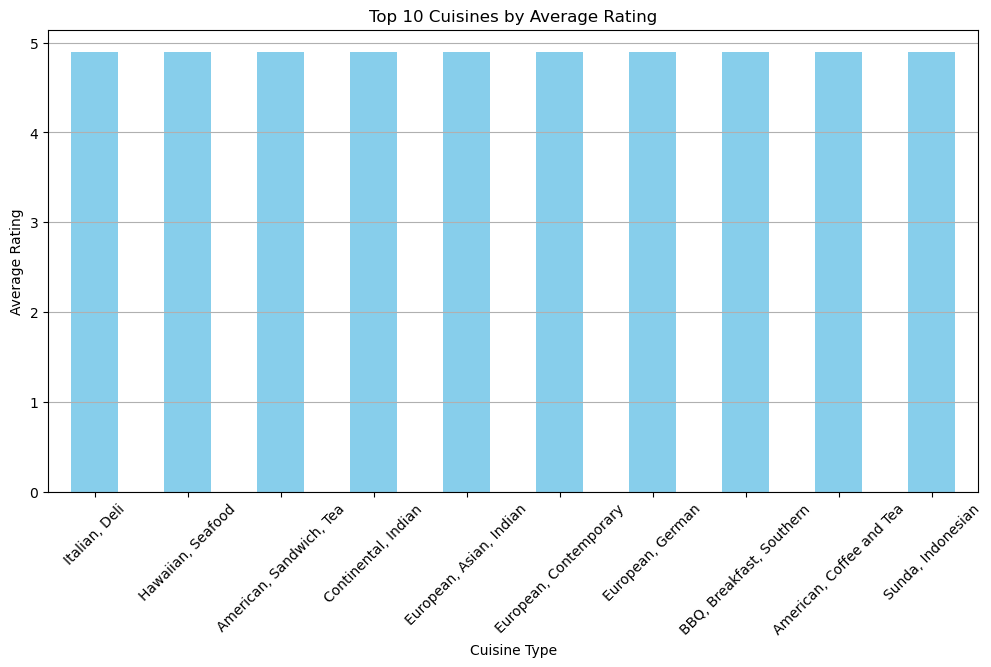

In [146]:
# Group the data by cuisine type and to the average rating for each cuisine
average_rating_by_cuisine = data.groupby('Cuisines')['Aggregate rating'].mean().sort_values(ascending=False)

# Plot the average rating for each cuisine
plt.figure(figsize=(12, 6))
average_rating_by_cuisine.head(10).plot(kind='bar', color='skyblue')
plt.title('Top 10 Cuisines by Average Rating')
plt.xlabel('Cuisine Type')
plt.ylabel('Average Rating')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()


## Visualize the relationship between various features and the target variable to gain insights.

<AxesSubplot:>

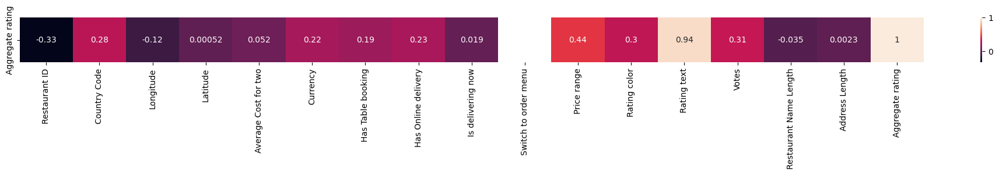

In [156]:
df = data
# Get the list of column names excluding 'Aggregate rating'
columns_without_rating = [col for col in df.columns if col != 'Aggregate rating']

# Reorder the columns with 'Aggregate rating' at the end
new_columns_order = columns_without_rating + ['Aggregate rating']

# Reindex the DataFrame with the new columns order
df = df.reindex(columns=new_columns_order)

# Display the updated DataFrame
df.head()

plt.figure(figsize= (25,1))
sns.heatmap(df.corr().tail(1), annot= True)

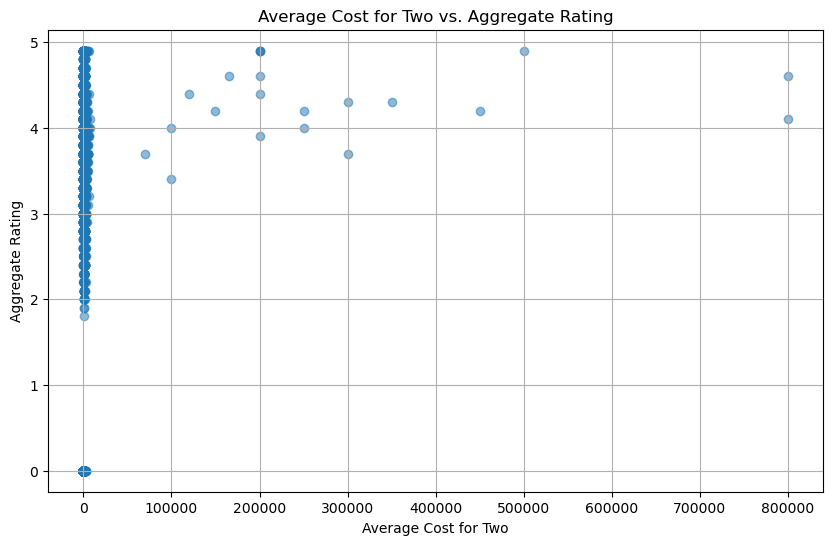

In [160]:
# Example scatter plot for 'Average Cost for two' vs. 'Aggregate rating'
plt.figure(figsize=(10, 6))
plt.scatter(data['Average Cost for two'], data['Aggregate rating'], alpha=0.5)
plt.title('Average Cost for Two vs. Aggregate Rating')
plt.xlabel('Average Cost for Two')
plt.ylabel('Aggregate Rating')
plt.grid(True)
plt.show()

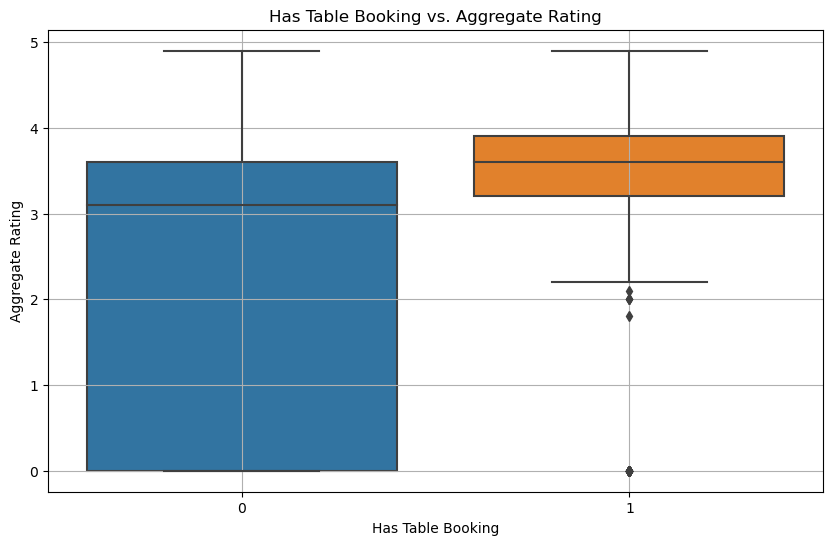

In [161]:
# Example box plot for 'Has Table booking' vs. 'Aggregate rating'
plt.figure(figsize=(10, 6))
sns.boxplot(x='Has Table booking', y='Aggregate rating', data=data)
plt.title('Has Table Booking vs. Aggregate Rating')
plt.xlabel('Has Table Booking')
plt.ylabel('Aggregate Rating')
plt.grid(True)
plt.show()

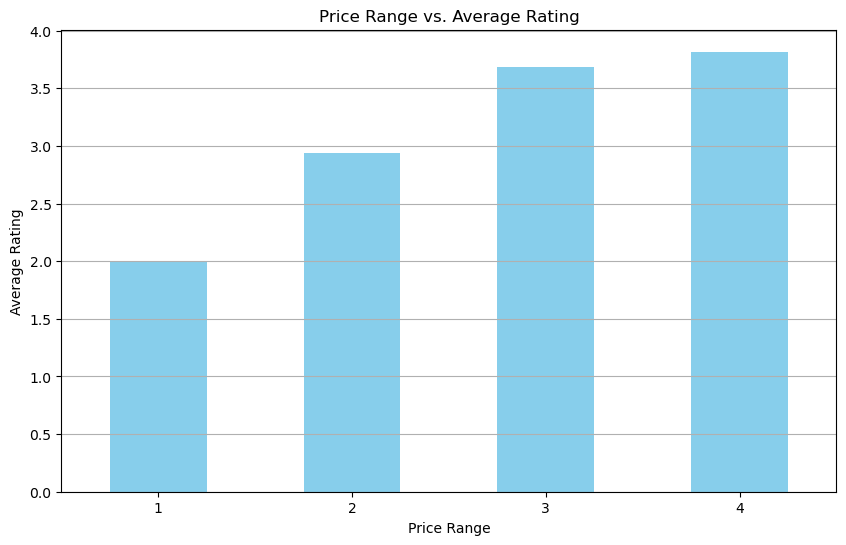

In [162]:
# Example bar plot for 'Price range' vs. 'Aggregate rating'
plt.figure(figsize=(10, 6))
data.groupby('Price range')['Aggregate rating'].mean().plot(kind='bar', color='skyblue')
plt.title('Price Range vs. Average Rating')
plt.xlabel('Price Range')
plt.ylabel('Average Rating')
plt.xticks(rotation=0)
plt.grid(axis='y')
plt.show()
